<a href="https://colab.research.google.com/github/Ruphasa/PCKV/blob/main/Week3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# PCVK Week 3

# D1. Operasi Citra Sederhana
## Connecting to Drive

In [1]:
from google.colab import drive

drive.mount('/content/drive')

Mounted at /content/drive


## Import library

In [2]:
import cv2 as cv
from google.colab.patches import cv2_imshow
from skimage import io
import matplotlib.pyplot as plt
import numpy as np

## Transformation Linear Brightness

 Mengubah tingkat kecerahan citra 
----------------------------------
Masukkan nilai kecerahan: 50


/tmp/ipython-input-751123510.py:15: RuntimeWarning: overflow encountered in scalar add
  brightness_image[y,x,c] = np.clip(original[y,x,c] + brightness, 0, 255)


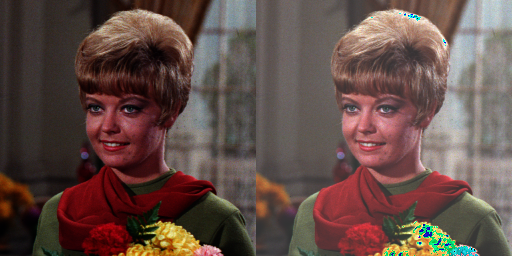

In [3]:
print(' Mengubah tingkat kecerahan citra ')
print('----------------------------------')
try:
  brightness = int(input('Masukkan nilai kecerahan: '))
except ValueError:
  print('Error, not a number')

original = cv.imread('/content/drive/MyDrive/PCVK_MM/Images/female.tiff')
brightness_image = np.zeros(original.shape, original.dtype)

#akses per piksel
for y in range(original.shape[0]):
  for x in range(original.shape[1]):
    for c in range(original.shape[2]):
      brightness_image[y,x,c] = np.clip(original[y,x,c] + brightness, 0, 255)
#cara simple tanpa for loop
#brightness_image cv.convertScaleAbs (original, beta-brightness)

final_frame=cv.hconcat((original, brightness_image))
cv2_imshow(final_frame)

# TUGAS PRAKTIKUM D1
## Implementasikan inverse citra pada Google Colaboratory menggunakan formula yang terdapat pada bagian Ulasan Teori :

 Membalikkan warna citra 
----------------------------------


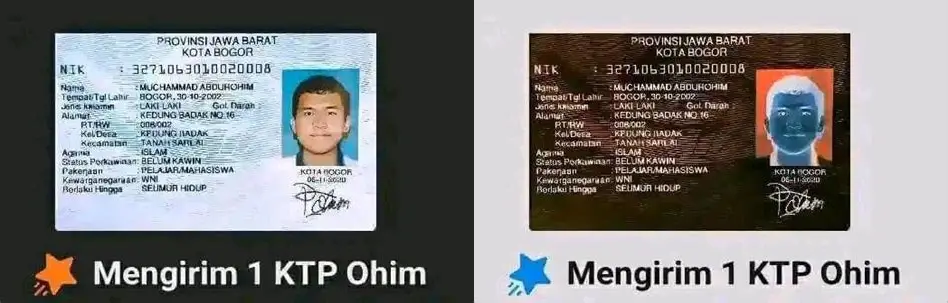

In [4]:
print(' Membalikkan warna citra ')
print('----------------------------------')

original = cv.imread('/content/drive/MyDrive/PCVK_MM/Images/ohim.png')
inverted_image = np.zeros(original.shape, original.dtype)

#akses per piksel
for y in range(original.shape[0]):
  for x in range(original.shape[1]):
    for c in range(original.shape[2]):
      inverted_image[y,x,c] = np.clip(255-original[y,x,c], 0, 255)

final_frame=cv.hconcat((original, inverted_image))
cv2_imshow(final_frame)

## implementasikan transformasi contrast pada Google Colaboratory menggunakan formula yang terdapat pada bagian Ulasan Teori untuk kontras

 Mengubah kontras citra 
----------------------------------
Masukkan nilai kecerahan dan kontras: 30


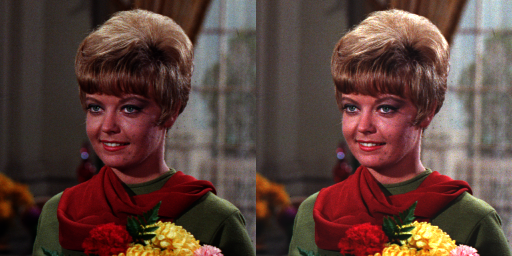

In [6]:
print(' Mengubah kontras citra ')
print('----------------------------------')

try:
  contras = int(input('Masukkan nilai kecerahan dan kontras: '))
except ValueError:
  print('Error, not a number')

contras = (259 *(contras + 255)) / (255 * (259 - contras))

original = cv.imread('/content/drive/MyDrive/PCVK_MM/Images/female.tiff')
kontras_image = np.zeros(original.shape, original.dtype)

#akses per piksel
for y in range(original.shape[0]):
  for x in range(original.shape[1]):
    for c in range(original.shape[2]):
      kontras_image[y,x,c] = np.clip(contras*original[y,x,c]+contras*10, 0, 255)

final_frame=cv.hconcat((original, kontras_image))
cv2_imshow(final_frame)

## Implementasikan transformasi logarithmic brightness pada Google Colaboratory menggunakan formula yang terdapat pada bagian Ulasan Teori untuk transformasi log

 Mengubah tingkat kecerahan logaritmik citra 
----------------------------------
Masukkan nilai kecerahan: 50


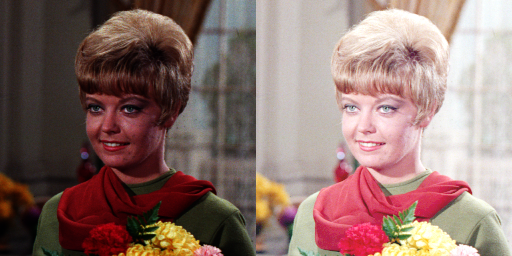

In [9]:
import math
from math import log

print(' Mengubah tingkat kecerahan logaritmik citra ')
print('----------------------------------')
try:
  brightness = int(input('Masukkan nilai kecerahan: '))
except ValueError:
  print('Error, not a number')

original = cv.imread('/content/drive/MyDrive/PCVK_MM/Images/female.tiff')
brightness_image = np.zeros(original.shape, original.dtype)

#akses per piksel
for y in range(original.shape[0]):
  for x in range(original.shape[1]):
    for c in range(original.shape[2]):
      brightness_image[y,x,c] = np.clip(brightness*log(1+original[y,x,c]), 0, 255)

final_frame=cv.hconcat((original, brightness_image))
cv2_imshow(final_frame)

## Implementasikan transformasi grayscale menggunakan metode averaging, lightness, dan luminance pada Google Colaboratory menggunakan formula yang terdapat pada bagian Ulasan Teori

 Mengubah Grayscale citra 
----------------------------------


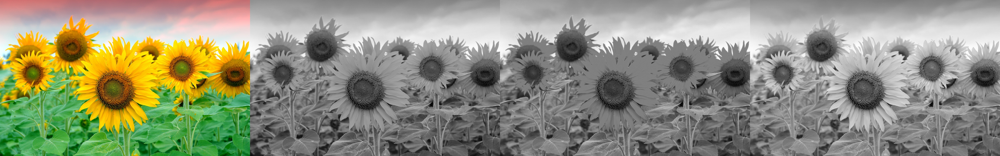

In [17]:
print(' Mengubah Grayscale citra ')
print('----------------------------------')

original = cv.imread('/content/drive/MyDrive/PCVK_MM/Images/sunfluwah.jpg')

# Averaging method
grayscale_avg = np.zeros((original.shape[0], original.shape[1]), dtype=np.int32)
for y in range(original.shape[0]):
  for x in range(original.shape[1]):
    grayscale_avg[y,x] = np.mean(original[y,x,:])

# Lightness method
grayscale_lightness = np.zeros((original.shape[0], original.shape[1]), dtype=np.int32)
for y in range(original.shape[0]):
  for x in range(original.shape[1]):
    grayscale_lightness[y,x] = (np.max(original[y,x,:]).astype(np.int32) + np.min(original[y,x,:]).astype(np.int32))/2

# Luminance method
grayscale_luminance = np.zeros((original.shape[0], original.shape[1]), dtype=np.int32)
for y in range(original.shape[0]):
  for x in range(original.shape[1]):
    grayscale_luminance[y,x] = 0.299*original[y,x,2] + 0.587*original[y,x,1] + 0.114*original[y,x,0]

# Convert grayscale images to uint8 and then to BGR to concatenate with the original color image
grayscale_avg_uint8 = np.clip(grayscale_avg, 0, 255).astype(np.uint8)
grayscale_lightness_uint8 = np.clip(grayscale_lightness, 0, 255).astype(np.uint8)
grayscale_luminance_uint8 = np.clip(grayscale_luminance, 0, 255).astype(np.uint8)

grayscale_avg_bgr = cv.cvtColor(grayscale_avg_uint8, cv.COLOR_GRAY2BGR)
grayscale_lightness_bgr = cv.cvtColor(grayscale_lightness_uint8, cv.COLOR_GRAY2BGR)
grayscale_luminance_bgr = cv.cvtColor(grayscale_luminance_uint8, cv.COLOR_GRAY2BGR)

final_frame = cv.hconcat((original, grayscale_avg_bgr, grayscale_lightness_bgr, grayscale_luminance_bgr))
cv2_imshow(final_frame)

## Tampilkanlah warna tertentu pada citra, dan ubah warna lain menjadi grayscale. Misal, tampilkan warna biru pada citra masukan dan ubah bagian lain yang tidak berwarna biru menjadi grayscale

 Menampilkan warna biru dan mengubah warna lain menjadi grayscale 
----------------------------------


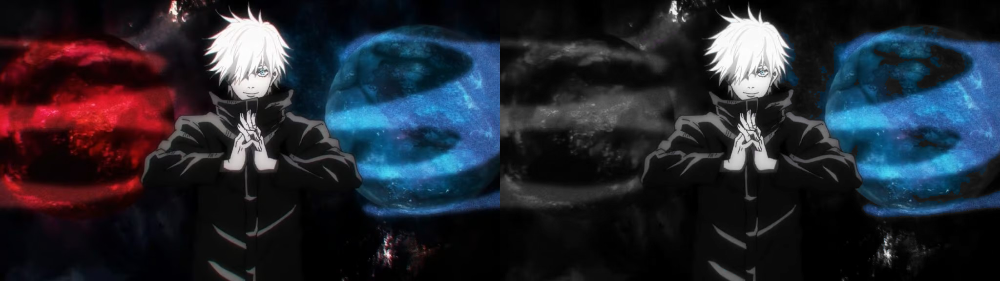

In [20]:
print(' Menampilkan warna biru dan mengubah warna lain menjadi grayscale ')
print('----------------------------------')

original = cv.imread('/content/drive/MyDrive/PCVK_MM/Images/KikoSatoru.jpg')

# Create a new image to store the result
blue_channel_grayscale = np.zeros_like(original)

# Luminance method for grayscale
def to_grayscale_luminance(pixel):
  return 0.299 * pixel[2] + 0.587 * pixel[1] + 0.114 * pixel[0]

# Iterate through pixels
for y in range(original.shape[0]):
  for x in range(original.shape[1]):
    blue = original[y, x, 0]
    green = original[y, x, 1]
    red = original[y, x, 2]

    # Check if the pixel is predominantly blue
    # You might need to adjust the thresholds based on your image
    if blue > red and blue > green and blue > 50:
        blue_channel_grayscale[y, x, 0] = blue
        blue_channel_grayscale[y, x, 1] = green
        blue_channel_grayscale[y, x, 2] = red
    else:
      # Convert to grayscale using luminance method
      gray_value = to_grayscale_luminance(original[y, x])
      blue_channel_grayscale[y, x, :] = gray_value


final_frame = cv.hconcat((original, blue_channel_grayscale))
cv2_imshow(final_frame)

# D2. Operasi Aritmatika dan Logika
## 1. Buat Gamma Correction sesuai dengan petunjuk berikut

## 2. Buat Simulasi Image Depth

## 3. Buat modul Average Denoising

## 4. Buat image masking